# GG4257 Final Project: A data driven approach to road saftey in Edinburgh

* **Authors:** Magnus Burnet

* **Student ID:** 190011602
* **Date:** 04/04/2024

**Abstract:**

This paper aims to create a model which sucessfully categorises different types of road accidents across Edinburgh using police data collected for 15000 accidents in the city. The categorisation will inclue variables such as Weather conditions, road conditions, speed limits, crash severity, number of casualties, age and gender of driver. It also aims to examine the role of node centrality in defining the types of crashes in Edinburgh. Identifying these clusters across Edinbugh can help inform policy makers interventions across the city to reduce the quanitiy and severity of road accidents.

**Keywords:** 'K-Means Clustering', 'Road Accidents', 'Edinburgh', 'Degree Centrality' 

# GitHub Repository
- **GitHub Link:** https://github.com/MagnusBurnet/GG4257_Final_Assessment
- **Google Drive Link:** https://drive.google.com/drive/folders/1WW-D_3u1vBAfpfLiKCSW4AocRTz9jHur?usp=share_link

## Declaration

> In submitting this assignment, I hereby confirm that I have read the University's statement on Good Academic Practice. The following work is my own. Significant academic debts and borrowings have been properly acknowledged and referenced.


**Data structure**

The files required for this dataset are provided in the repository for this workbook uner the files 'Data_2' and 'Edinburgh_OA'. The datapath should not have to be altered to load this data.

The data originates from a much larger dataset, too large to upload to this repository. If you want to view this data it is available via the linked google drive. 

**Table of Contents:** 

## Table of Contents:
1. Introduction
2. Methodology
   - 2.1. Data Loading and Preprocessing
   - 2.2. Node Degree Centrality Calculation
   - 2.3. Data Recategorisation and Standardisation
     - 2.3.1. Recategorisation
     - 2.3.2. One-Hot-Encoding
   - 2.4. K-means Clustering Preparation
     - 2.4.1. Calculating Counts and Standardizing between each Output Area
     - 2.4.2. Measuring Variables for Correlation
   - 2.5. K-Means Clustering
     - 2.5.1. Principle Component Analysis (PCA)
     - 2.5.2. Interpretation of Cluster Centers
     - 2.5.3. Consolidation
3. Results
   - 3.1. Visualising Edinburgh Crashes and Road Network Connectivity
   - 3.2. K-mean Clusters for Edinburgh Road Accidents
4. Discussion
   - 4.1. Limitations
   - 4.2. Conclusions
5. Appendix
   - 5.1. Appendix A
   - 5.2. Appendix B
   - 5.3. Appendix C


## Introduction

Globally, the number of traffic accidents are on the rise, costing most countries around the world an average of 3% of their GDP (WHO, 2018). More critically they also pose a serious concern to public health, with the number of traffic deaths reaching 1.35 million in 2016(ibid). Navigating the intricacies of road safety poses a serious challenge for public health and a complex issue for infrastructure planning. Cities need to strike a ballence, ensuring the safety of their citizens while also remaining connected and accessable. 

In pursuit of setting a global benchmark, the Scottish government has articulated its aim. to have ‘the best road safety performance in the world’. It has set out plans to decreasing frequency and severity of road accidents. It aims to do this by targeting a range of social and infrastructural policy areas with a focus on creating safer roads making them ‘predictable and forgiving of errors’ and post-crash response by facilitating ‘effective and appropriate response to collisions’ (Transport Sotland, nd). Edinburgh, the countries capital, has implemented some of the most aggressive policy’s tackling road accidents by applying near blanket 20mph limits across 80% of its roads(Nightingale et al., 2021). This has had positive impacts, leading to an 8% reduction in collisions and a 10% reduction in casualties for streets that dropped from a 30mph limit to a 20mph limit (Hunter et al., 2022).

This report calls for a more granular, data driven approach to road saftey. Targeted responses may yeild better and more affordable results. However, specific interventions can be tricky due to the complexity of individual crashes. Literature shows that the interaction between several environmental, infrastructural and driver error factors determine the occurrence and magnitude of a car accident(Pembuain et al., 2019). The  interplay of these factors make each crash unique, and can make crash prediction hard.

This report hopes to help inform more local level, targeted intervention to takling road accidents and crash fatalities. It will do this by using machine learing algorithms to identify clusters of crash patterns that occur under similar conditions. It will then plot these over Edinburgh’s 4322 output areas. This can help policy makers highlight areas characterized by particular types of road accident. Identifying these localised problem areas can higlight areas in need of intervention, and also inform specific adjustments that can be made to reduce road accidents.

The model will be informed by details from a comprehensive dataset, compromising of vehicle and driver crash data for over 15000 crashes that happened in Edinburgh between 2005 and 2016. The dataset covers a spectrum of variables including weather conditions, road conditions, speed limits, crash severity, number of casualties, as well as the gender and age of the driver involved. These offer a comprehensive lens through which the dynamics of road accidents in Edinburgh can be examined.

Additionally, this analysis will extend to examine the role of node centrality in road accidents. Node degree centrality is a measure of a points particular importance in a network by calculating its connectivity to other nodes in the network. Node connectivity is an important metric in determining accident rates. The European Commision reports that in most countries, 40-60% of accidents happen at junctions (European Commission). Therefore, by incorporating node centrality variables into this analysis, road network vulnerabilities and patterns can be identified and interventions formed.

## Methodology

This section details the methods of data collection, data pre-processing, and model building process that was used in the analysis of Edinburgh road accidents.

It only includes figures necessary for the model building process.

In [1]:
# Import necessary libraries
import pandas as pd 
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import networkx as nx
import osmnx as ox
import folium
from folium import plugins
from scipy.spatial import cKDTree
from shapely.geometry import Point
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist, pdist
import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import warnings
from lonboard import Map, ScatterplotLayer, SolidPolygonLayer

### Data loading and preprocessing

The dataset used in this analysis was downloadedfrom [Kaggle](https://www.kaggle.com/datasets/tsiaras/uk-road-safety-accidents-and-vehicles). It is a detailed dataset of road accidents and involved vehicles in the UK between 2005 and 2017. The data has been compiled from opensource data from the UK Department of Transport. 

The dataset consisted of 2 files, 1 detailing vehicle information, and 1 detailing driver and calsualy information.

These were these were large files, so the data provided for this notebook has been pre-merged and filtered to only include Scottish crash data. The code for this preprocessing can be found in appendix A. The dataset provided has been cleaned and preformated.

In [2]:
#Reading in the crash CSV data
crash_data = pd.read_csv("Data_2/Merged_Crash_Data.csv")
#Reading in the Edinbugh output area shapefile
edinburgh_oa = gpd.read_file("Edinburgh_OA/scotland_oa_2011.shp")

/var/folders/83/1x40589d0tn93j0bfb0vc2q80000gn/T/ipykernel_11069/4163819013.py:2: DtypeWarning: Columns (19) have mixed types. Specify dtype option on import or set low_memory=False.
  crash_data = pd.read_csv("Data_2/Merged_Crash_Data.csv")


The crash data neeeds to be clipped to only include Edinburgh data and to be categoriesed by output areas. 
To do this the the crash data is converted to a geodataframe and joined with the output area (OA) shapefile.

In [3]:
#Convert crash data to geodataframe using latitude and longitude crash data
crash_gdf = gpd.GeoDataFrame(crash_data, crs = 'EPSG:4326', geometry=gpd.points_from_xy(crash_data['Longitude'], crash_data['Latitude']))

#Project (OA) shapefile to match crash data
edinburgh_oa = edinburgh_oa.to_crs('EPSG:4326')

#spatially join the shape files using 'within' to only keep data within the City of Edinburgh
edinburgh_data = gpd.sjoin(crash_gdf, edinburgh_oa, how="inner", predicate="within")

### Node Degree Centrality Calculation

Degree Centrality is a measure of how many connections a particular point has relative to the total network. It is a factor being included in this analysis and is integrated in the following steps:

1. Loading in node network
2. Calculating Degree centrality for each node
3. Connecting each crash to its closest node

In [4]:
#Use NeworkX to download the Edinburgh street network
Edin = ox.graph_from_place("Edinburgh, Scotland", network_type="drive")

# Set degree centrality as a node attribute
nx.set_node_attributes(Edin, nx.degree_centrality(Edin),name= "degree_centrality")

# Convert to GeoDataFramee
nodes, edges = ox.graph_to_gdfs(Edin)

In [5]:
#Find nearest point points between two data frames
#Code adapted from: https://gis.stackexchange.com/questions/222315/finding-nearest-point-in-other-geodataframe-using-geopandas

#Define function that uses a  k-dimentional tree to find the nearest neighbors between the two dataframes.
def ckdnearest(gdA, gdB):

    nA = np.array(list(gdA.geometry.apply(lambda x: (x.x, x.y))))
    nB = np.array(list(gdB.geometry.apply(lambda x: (x.x, x.y))))
    btree = cKDTree(nB)
    dist, idx = btree.query(nA, k=1)
    gdB_nearest = gdB.iloc[idx].drop(columns="geometry").reset_index(drop=True)
    gdf = pd.concat(
        [
            gdA.reset_index(drop=True),
            gdB_nearest,
            pd.Series(dist, name='dist')
        ], 
        axis=1)

    return gdf

#Create new dataframe with crash data linked to closest node data 
crashes_and_centrality = ckdnearest(edinburgh_data, nodes)

In [6]:
#Filter data to remove unnecessary columns
keep_cols= [
    'Accident_Index',
    'code',
    'council',
    'Latitude',
    'Longitude',
    'geometry',
    'Accident_Severity',
    'Number_of_Vehicles',
    'Number_of_Casualties',
    'Road_Surface_Conditions',
    'Weather_Conditions',
    'Light_Conditions',
    'Age_Band_of_Driver',
    'Age_of_Vehicle',
    'Sex_of_Driver',
    'Speed_limit',
    'Engine_Capacity_.CC.',
    'degree_centrality'
]
filter_data = crashes_and_centrality[keep_cols]

### Data Recategorisation and Standardisation 

Each variable in the dataset contains many unique variables. Often times there are too many to make meaningful observations about each cluster from.

In this section the variables are recategorised and consolidated into larger groups that reflect the distribution of each variable. 

This will be done in the following steps:

1. Recategorisation of variables into the following categories:

| Variable         | Categories        | Values                           |
|------------------|-------------------|----------------------------------|
| Weather conditions | Fine            | - Fine no high winds             |
|                  |                   | - Raining no high winds          |
||-------------------|----------------------------------|
|                  | Lower Visibility  | - Fog or mist                    |
|                  |                   | - Snowing no high winds          |
||-------------------|----------------------------------|
|                  | High Winds        | - Fine high winds                |
|                  |                   | - Raining high winds             |
|                  |                   | - Snowing high winds             |
|------------------|-------------------|----------------------------------|
| Light Conditions | Daylight          | - Daylight                       |
||-------------------|----------------------------------|
|                  | Dark but lit      | - Darkness: streetlight lit      |
||-------------------|----------------------------------|
|                  | Complete Darkness | - Darkness: No Street lighting   |
|                  |                   | - Darkness: Streetlights not lit |
|                  |                   | - Darkness: Streetlighting unknown |
|------------------|-------------------|----------------------------------|
| Road Conditions  | Dry               | - Dry                            |
||-------------------|----------------------------------|
|                  | Wet               | - Wet/Damp                       |
|                  |                   | - Flood                          |
||-------------------|----------------------------------|
|                  | Icy               | - Frost/Ice                      |
|                  |                   | - Snow                           |
|------------------|-------------------|----------------------------------|
| No. of Vehicles  | 1 vehicle         |                                  |
|                  | 2 vehicles        |                                  |
|                  | 3 or more vehicles|                                  |
|------------------|-------------------|----------------------------------|
| No. of Casualties| 1 casualty        |                                  |
|                  | 2-3 casualties    |                                  |
|                  | 3 or more casualties |                              |
|------------------|-------------------|----------------------------------|
| Crash Severity   | Slight            |                                  |
|                  | Serious           |                                  |
|                  | Fatal             |                                  |
|------------------|-------------------|----------------------------------|
| Speed Limit      | 20-30             |                                  |
|                  | 40-50             |                                  |
|                  | 60 or more        |                                  |
|------------------|-------------------|----------------------------------|
| Driver Sex       | Male              |                                  |
|                  | Female            |                                  |
|------------------|-------------------|----------------------------------|r
 
2. The categories are then pivoted and the dataframe converted to binary. This is known as [One-Hot-Encoding](https://machinelearningmastery.com/why-one-hot-encode-data-in-machine-learning/) and is necessary as all the the data is now all catagorical. This method will allow us to create a standardised count of evey variable.


#### Recategorisation

Each variable was recategorised using the method below.

In [7]:
warnings.filterwarnings('ignore')

#Define a function that recategorises light conditions into the broader categories.
def categorize_light(row):
    if pd.isna(row['Light_Conditions']):
        return np.nan
    elif row['Light_Conditions'] == 'Daylight':
        return 'Daylight'
    elif row['Light_Conditions'] in ['Darkness - lights lit']:
        return 'Dark_but_Lit'
    elif row['Light_Conditions'] in ['Darkness - lights unlit', 'Darkness - no lighting', 'Darkness: Street lighting unknown']:
        return 'Complete_Darkness'
    else:
        return np.nan
filter_data['Light_Category'] = filter_data.apply(categorize_light, axis=1)

#Define function that recategorises weather conditiions into the broader categories
def categorize_weather(row):
    if row['Weather_Conditions'] == 'Fine no high winds':
        return 'Fine'
    elif row['Weather_Conditions'] in ['Snowing no high winds', 'Raining no high winds', 'Fog or mist']:
        return 'Lower_Visability'
    elif row['Weather_Conditions'] in ['Fine + high winds', 'Raining + high winds', 'Snowing + high winds']:
        return 'High_Winds'
    else:
        return np.nan        
filter_data['Weather_Category'] = filter_data.apply(categorize_weather, axis=1)

#Define function that recategorises casualties into the broader categories
def categorize_casualties(row):
    if pd.isna(row['Number_of_Casualties']):
        return np.nan
    elif row['Number_of_Casualties'] == 1:
        return '1_Casualty'
    elif 2 <= row['Number_of_Casualties'] <= 3:
        return '2_to_3_Casualties'
    else: 
        return 'More_than_3_Casualties'
filter_data['Casualty_Category'] = filter_data.apply(categorize_casualties, axis=1)

#Define function that recategorises vehicle numbers into the broader categories
def categorize_vehicles(row):
    if pd.isna(row['Number_of_Vehicles']):
        return np.nan
    elif row['Number_of_Vehicles'] == 1:
        return '1_Vehicle'
    elif row['Number_of_Vehicles'] == 2:
        return '2_Vehicles'
    else: 
        return '3_or_more_Vehicles'
filter_data['Vehicle_Category'] = filter_data.apply(categorize_vehicles, axis=1)

#Define function that recategorises road conditions into the broader categories
def categorize_road_conditions(row):
    if pd.isna(row['Road_Surface_Conditions']):
        return np.nan
    elif row['Road_Surface_Conditions'] == 'Dry':
        return 'Road_Dry'
    elif row['Road_Surface_Conditions'] in ['Wet or damp', 'Flood over 3cm. deep']:
        return 'Road_Wet'
    elif row['Road_Surface_Conditions'] in ['Frost or ice', 'Snow']:
        return 'Road_Icy'
    else:
        return np.nan
filter_data['Surface_Condition_Category'] = filter_data.apply(categorize_road_conditions, axis=1)

#Define function that recategorises Speed Limits into the broader categories
def categorize_speed(row):
    if pd.isna(row['Speed_limit']):
        return np.nan
    elif 20 <= row['Speed_limit'] <= 30:
        return 'Speed_20_to_30'
    elif 40 <= row['Speed_limit'] <= 50:
        return 'Speed_40_to_50'
    elif 60 <= row['Speed_limit'] <= 70:
        return 'Speed_60_Plus'
    else:  
        return np.nan
filter_data['Speed_Category'] = filter_data.apply(categorize_speed, axis=1)

#Define function that recategorises Driver aged into the broader categories
def categorize_age(row):
    if pd.isna(row['Age_Band_of_Driver']):
        return np.nan
    elif row['Age_Band_of_Driver'] in ['0 - 5', '6 - 10', '11 - 15', '16 - 20', '21 - 25', '26 - 35']:
        return 'Young'
    elif row['Age_Band_of_Driver'] in  ['36 - 45', '46 - 55', '56 - 65']:
        return 'Middle_Aged'
    elif row['Age_Band_of_Driver'] in ['66 - 75', 'Over 75']:
        return 'Senior'
    else:
        return np.nan
filter_data['Age_Category'] = filter_data.apply(categorize_age, axis=1)

#Define function that recategorises Driver sex into the broader categories
def categorize_sex(row):
    if pd.isna(row['Sex_of_Driver']):
        return np.nan
    elif row['Sex_of_Driver'] == 'Female':
        return 'Female'
    elif row['Sex_of_Driver'] == 'Male':
        return 'Male'
    else:  
        return np.nan
filter_data['Driver_Sex'] = filter_data.apply(categorize_sex, axis=1)

#Define function that recategorises degree centrality into the broader categories
def categorize_centrality(row):
    if pd.isna(row['degree_centrality']):
        return np.nan
    elif row['degree_centrality'] < 0.0003:
        return 'Low_Centrality'
    elif row['degree_centrality'] < 0.0005:
        return 'Medium_Centrality'
    else:
        return 'High_Centrality'
filter_data['centrality_category'] = filter_data.apply(categorize_centrality, axis=1)

In [8]:
#Create subset dataframe of only recategorized and accident id data.
keep_cols = ['code',
             'Accident_Index',
             'centrality_category',
             'Driver_Sex',
             'Age_Category',
             'Speed_Category',
             'Surface_Condition_Category',
             'Vehicle_Category',
             'Casualty_Category',
             'Light_Category',
             'Weather_Category',
             'Accident_Severity',
            ]

categorised_data = filter_data[keep_cols]

#### One-Hot-Encoding

In this step the categorised data is pivoted out and the details of each crash recoded in binary.

Firstly, a unique ID needs to be created. The nature of the data collection means that if a crash occurs between two or more vehicles, the details are stored under the same 'Accident_index'. The unique ID keeps the accidents_seperate in one-hot-encoding. 

By the end of this process, we'll have a data frame where each crashes details are encoded in a way that can be easily used for further data analysis.

In [9]:
categorised_data['Unique_id'] = categorised_data.index

With a unique identifier in place for each crash, we proceed to recode the dataframe.

In [10]:
#Code adapted from: https://www.codium.ai/blog/pandas-pivot-tables-a-comprehensive-guide-for-data-science/#:~:text=To%20use%20pivot_table()%2C%20you,s)%20using%20the%20aggfunc%20parameter.

#Define the variable for pivoting
variables = [
    'centrality_category',
             'Driver_Sex',
             'Age_Category',
             'Speed_Category',
             'Surface_Condition_Category',
             'Vehicle_Category',
             'Casualty_Category',
             'Light_Category',
             'Weather_Category',
             'Accident_Severity',
]

def pivot_accidents(data):
    # Melt the dataframe to long format
    melted = pd.melt(data, id_vars=['Unique_id'], value_vars=variables)
    
    # Pivot to wide format with binary indicators
    pivoted = melted.pivot_table(index='Unique_id', 
                                 columns='value', 
                                 aggfunc=len, 
                                 fill_value=0)
    
    # Flatten the MultiIndex in columns
    pivoted.columns = ['_'.join(col).strip() for col in pivoted.columns.values]
    
    return pivoted.reset_index()

# Apply the function to your categorised data
pivoted_data = pivot_accidents(categorised_data)

In [11]:
#Merge back with categorised data to retain output areas 'code'
pivoted_merged = pivoted_data.merge(categorised_data, on = 'Unique_id')

#Subset to only include pivoted data and output area 'code'
keep_cols =['code',
            'Accident_Index',
            'variable_1_Casualty',
            'variable_2_to_3_Casualties',
            'variable_More_than_3_Casualties',
            'variable_1_Vehicle',
            'variable_2_Vehicles',
            'variable_3_or_more_Vehicles',
            'variable_Complete_Darkness',
            'variable_Dark_but_Lit',
            'variable_Daylight',
            'variable_Fatal',
            'variable_Slight',
            'variable_Serious',
            'variable_Female',
            'variable_Male',
            'variable_Fine',
            'variable_High_Winds',
            'variable_Lower_Visability',
            'variable_Low_Centrality',
            'variable_Medium_Centrality',
            'variable_High_Centrality',
            'variable_Young',
            'variable_Middle_Aged',
            'variable_Senior',
            'variable_Road_Dry',
            'variable_Road_Icy',
            'variable_Road_Wet',
            'variable_Speed_20_to_30',
            'variable_Speed_40_to_50',
            'variable_Speed_60_Plus',
]

pivoted_merged = pivoted_merged[keep_cols]

### K-means clustering preperation

In this section, the data is preprared for k-means cluster analysis by the following steps

1. Values are counted for each cluster
2. Output areas are standardised
3. Variables are standardised
4. Variables are measured for association.

#### Calculating Counts and Standardizing between each output area.

**1. Variable counts:** For every output area, the occurances of every variable wil be tallied. The variables were selected through a series of trial and error by in which a model with the best fit was selected.

**2. Total Crash Count:** A total number of crashes will also be calculated.

**3. Standardization between Output Areas:** In order to make the data comparable across different output areas the variable counts will be standardized. This will be done by converting the raw counts to percentages of the total number of crashes for each output area.

**4. Standardization between variables:** In order that eratic variables do not contribute an unequal weighting to the final clusters, the input variables must be standardized. This will be done by calculating Z-scores for each variable. This is the number of standard deviations the value is away from the data mean.

In [12]:
#Add variable to provide a total crash count for every output area
pivoted_merged['Total Count'] = 1

#Drop 'Accident_Index' and count variable occurences by each 'code' (Output Area)
oa_counts = pivoted_merged.drop('Accident_Index', axis=1).groupby('code').sum()

#Create new dataframe of standardised counts for each output area. 
df_percentages = oa_counts.copy()

#Run for every column except for code and total count
for col in df_percentages.columns:
    if col not in ['code', 'Total Count']:
        df_percentages[col] = (df_percentages[col] / df_percentages['Total Count']) * 100

# Now df_percentages will have the values as percentages of the 'Total Count'

#Select variables for k-means clustering
keep_cols = ['variable_Complete_Darkness', 'variable_Dark_but_Lit', 'variable_Speed_20_to_30',
       'variable_Speed_40_to_50', 'variable_Speed_60_Plus', 'variable_Female', 'variable_Male', 'variable_Low_Centrality',
       'variable_Medium_Centrality', 'variable_High_Centrality', 'variable_Fatal', 'variable_Serious', 'variable_Slight','variable_Road_Icy', 'variable_Road_Dry', 'variable_Road_Wet']

final_df = df_percentages[keep_cols]

In [13]:
#Standardization between variables using z-score
numeric_columns = final_df
z_score_df = (numeric_columns - numeric_columns.mean()) / numeric_columns.std(ddof=0)

In [14]:
z_score_df.head()

,variable_Complete_Darkness,variable_Dark_but_Lit,variable_Speed_20_to_30,variable_Speed_40_to_50,variable_Speed_60_Plus,variable_Female,variable_Male,variable_Low_Centrality,variable_Medium_Centrality,variable_High_Centrality,variable_Fatal,variable_Serious,variable_Slight,variable_Road_Icy,variable_Road_Dry,variable_Road_Wet
code,,,,,,,,,,,,,,,,
S00103303,0.279952,-0.485850,-4.003967,1.010739,6.584645,0.096844,0.152102,1.516786,-0.888351,-0.468282,0.156256,-0.162073,0.119882,-0.165046,0.003582,0.060785
S00103304,-0.008894,-0.108562,-2.192818,0.559250,3.595985,-0.125128,0.211485,1.960840,-1.254149,-0.468282,0.093230,-0.253776,0.224353,0.212776,-0.120290,0.041682
S00103305,0.165784,0.369885,-3.133366,2.094846,2.829334,0.495421,-0.346215,1.357185,-0.756876,-0.468282,-0.111941,-0.323350,0.341684,-0.191467,0.177247,-0.109120
S00103306,-0.222390,-0.693331,0.323784,-0.295187,-0.152088,2.487307,-2.040491,-0.552684,0.816418,-0.468282,-0.111941,-0.508879,0.522194,7.893390,-2.175369,-0.827227
S00103307,1.326038,-0.619891,-4.002681,-0.295187,8.909189,0.227704,0.007535,1.591046,-0.949524,-0.468282,-0.111941,-0.194906,0.216716,-0.058200,-0.469076,0.509556


#### Measuring variables for correlation

In this step the variables are tested against eachother for high correlation. If two variables are highly correlated, they would influence the clusters by giving a particular phenomenon undue weighting. This is because highly correlated variables essentially show the same distribution. This was done in the following steps: 

1. Pearsons coefficent matrix is calculated for the dataframe
2. Variables with a correlation greater than ±0.8 are removed due to high correlation.                     

In [15]:
#creation of correlation matrix
corr = z_score_df.corr()
corr.style.background_gradient(cmap='coolwarm')

,variable_Complete_Darkness,variable_Dark_but_Lit,variable_Speed_20_to_30,variable_Speed_40_to_50,variable_Speed_60_Plus,variable_Female,variable_Male,variable_Low_Centrality,variable_Medium_Centrality,variable_High_Centrality,variable_Fatal,variable_Serious,variable_Slight,variable_Road_Icy,variable_Road_Dry,variable_Road_Wet
variable_Complete_Darkness,1.000000,-0.083968,-0.124133,0.050690,0.169649,0.019530,-0.001493,-0.023876,0.023674,-0.005194,-0.014581,0.034290,-0.029834,-0.002310,-0.006349,0.007492
variable_Dark_but_Lit,-0.083968,1.000000,0.030146,0.006487,-0.074697,-0.092456,0.027617,-0.015494,0.001610,0.014462,0.044357,0.043471,-0.053027,0.055058,-0.189727,0.175382
variable_Speed_20_to_30,-0.124133,0.030146,1.000000,-0.879103,-0.527772,-0.002950,-0.038780,-0.244424,0.115013,0.111952,-0.049829,-0.008781,0.020599,-0.009019,0.030382,-0.028006
variable_Speed_40_to_50,0.050690,0.006487,-0.879103,1.000000,0.059121,-0.002898,0.034301,0.194192,-0.084042,-0.098455,0.050937,0.018584,-0.030405,-0.002588,-0.003340,0.004478
variable_Speed_60_Plus,0.169649,-0.074697,-0.527772,0.059121,1.000000,0.011342,0.020093,0.165857,-0.091114,-0.059019,0.013588,-0.014727,0.011041,0.023501,-0.057679,0.050675
variable_Female,0.019530,-0.092456,-0.002950,-0.002898,0.011342,1.000000,-0.814274,-0.006578,0.000084,0.006918,-0.052771,-0.079866,0.090472,0.033362,-0.023058,0.010892
variable_Male,-0.001493,0.027617,-0.038780,0.034301,0.020093,-0.814274,1.000000,0.015524,-0.025170,0.016055,0.045819,0.064726,-0.074060,-0.035606,-0.007921,0.022135
variable_Low_Centrality,-0.023876,-0.015494,-0.244424,0.194192,0.165857,-0.006578,0.015524,1.000000,-0.657869,-0.215125,0.020540,-0.035943,0.030001,0.032696,-0.025431,0.013615
variable_Medium_Centrality,0.023674,0.001610,0.115013,-0.084042,-0.091114,0.000084,-0.025170,-0.657869,1.000000,-0.593975,-0.024534,0.056599,-0.049132,0.013493,0.034562,-0.041142
variable_High_Centrality,-0.005194,0.014462,0.111952,-0.098455,-0.059019,0.006918,0.016055,-0.215125,-0.593975,1.000000,0.009872,-0.034997,0.031662,-0.052421,-0.017652,0.038806


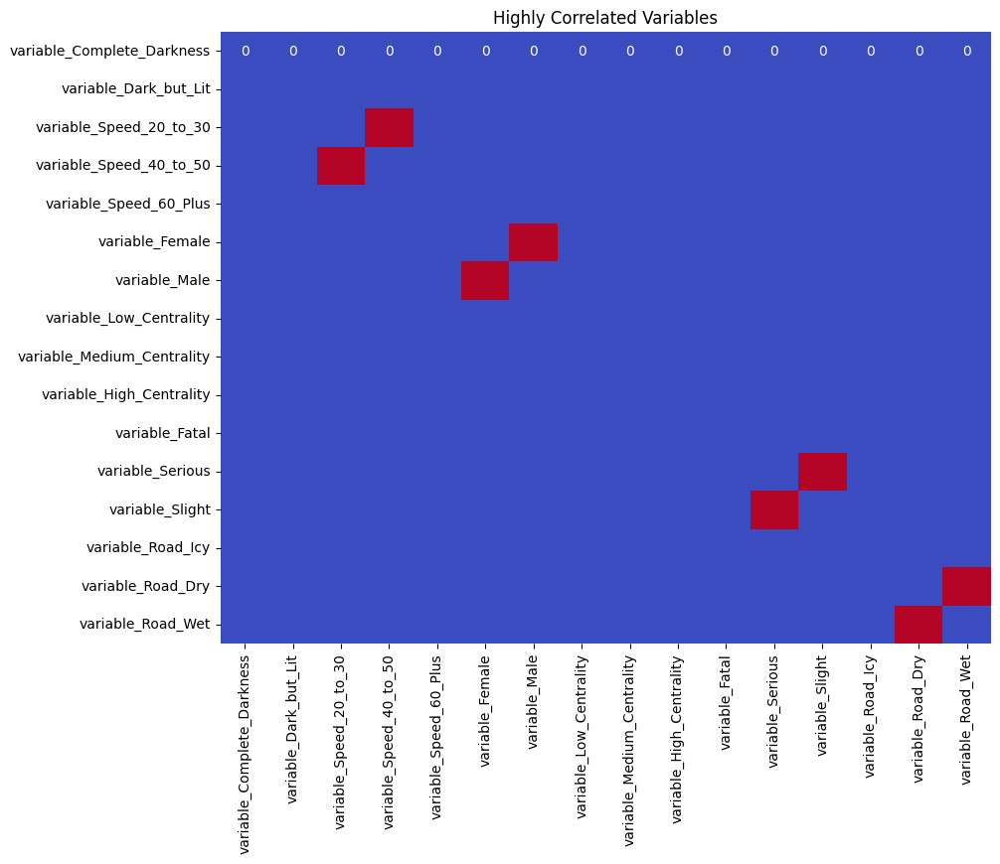

In [16]:
#For ease of interpretation, the following code plots the same table however highlights only the variables with greater than ±0.75 correlation.
threshold = 0.75 

highly_correlated = (corr.abs() > threshold) & (corr.abs() < 1.0)

#Use heat map to help differentiate between highly correlated relationships
plt.figure(figsize=(10, 8))
sns.heatmap(highly_correlated, cmap='coolwarm', cbar=False, annot=True)

plt.title('Highly Correlated Variables')
plt.show()

The coefficient matrix shows that several features are highly correlated.

* variable_Speed_40_to_50 & variable_Speed_20_to_30
* variable_Male & variable_Female
* variable_Serious & variable_Slight
* variable_Road_Dry & variable_Road_Wet

To avoid collinearity, half of each pair of variables are removed.

In [17]:
z_score_df.drop(['variable_Speed_40_to_50', 'variable_Serious', 'variable_Male','variable_Road_Dry'], axis=1, inplace=True)

In [18]:
contains_nan = z_score_df.isna().any().any()

if contains_nan:
    print("The DataFrame contains NaN values.")
else:
    print("The dataFrame does not contain NaN values")

The dataFrame does not contain NaN values


### K-Means Clustering

K-means clustering Is a machine learning algorithm which identifies patterns in large datasets. 

It does this by randomly distributing k centroids within the data. Each datapoint is then attached to its closest centroid. The mean of this cluster is calculated and a new k centroid is created. This is repeated until the distance between every datapoint and the centroids can no longer be reduced or when the specified number of iterations is reached.

K-means clustering was selected as it can cluster large datasets with reduced computational expense.

In this analysis, the optimum number of clusters is determined using the Elbow method. In this method the k-means cluster is run multiple times using increasing numbers of clusters. The within-cluster sum of squares (WCSS) is calculated. This is a measure of the compactness of a cluster. The point at which the decrease in WCSS begins to slow, indicates at which point adding more clusters does nto significaltly improve the model fit. This is known as the Elbow..


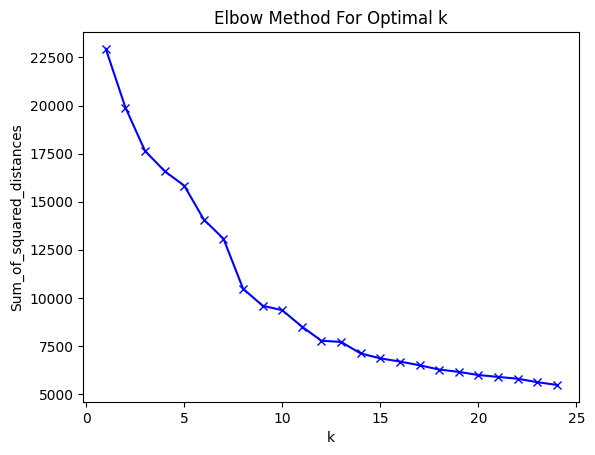

In [19]:
#Plot the WCSS for 45 clusters
Sum_of_squared_distances = []
K_range = range(1,25)

for k in K_range:
 km = KMeans(n_clusters=k, random_state=45)
 km = km.fit(z_score_df)
 Sum_of_squared_distances.append(km.inertia_)
    
plt.plot(K_range, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

The **WCSS** plot shows the elbow to be at around 9 clusters. 

To confirm this we can examine the between-cluster sum of squares. This next plot shows how discriminatory each model is when different numbers of groups are produced.

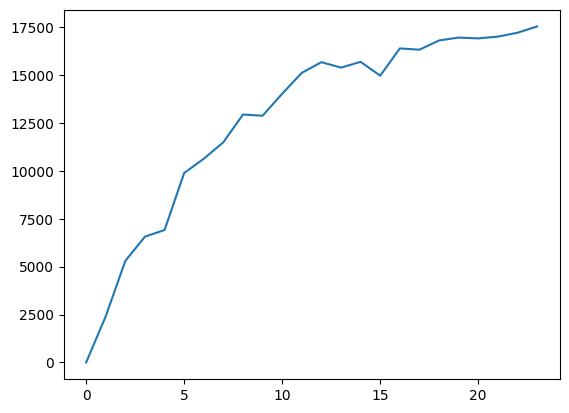

In [20]:
def elbow(dataframe, n):
    kMeansVar = [KMeans(n_clusters=k).fit(dataframe.values) for k in range(1, n)]
    centroids = [X.cluster_centers_ for X in kMeansVar]
    k_euclid = [cdist(dataframe.values, cent) for cent in centroids]
    dist = [np.min(ke, axis=1) for ke in k_euclid]
    wcss = [sum(d**2) for d in dist]
    tss = sum(pdist(dataframe.values)**2)/dataframe.values.shape[0]
    bss = tss - wcss
    plt.plot(bss)
    plt.show()
 
elbow(z_score_df,25)

The between-cluster sum of squares plot confirms the elbow to be between 9 and 11.
Resultingly, this analysis will use 9 cluster groups to define road accidents across Edinburgh.

In [21]:
#Define the number of clusters and the random state to ensure reproducability
kmeans = KMeans(n_clusters=9, random_state = 45)

(array([332., 297., 273.,  31.,   0., 803.,  15.,  33.,  30.,  98.]),
 array([0. , 0.8, 1.6, 2.4, 3.2, 4. , 4.8, 5.6, 6.4, 7.2, 8. ]),
 <BarContainer object of 10 artists>)

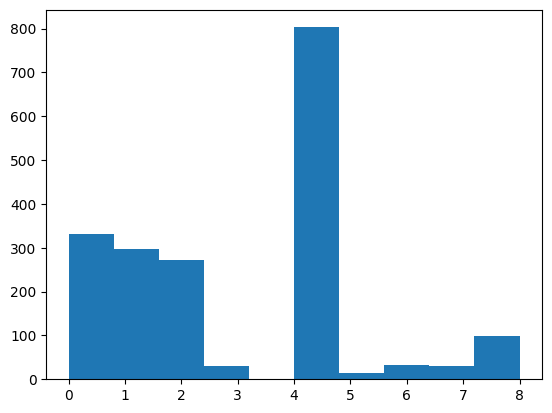

In [22]:
#Apply k-means clustering on the dataframe using the parameters set.
kmeans.fit(z_score_df)
labels = kmeans.predict(z_score_df)
cluster_centres = kmeans.cluster_centers_
z_score_df['Cluster'] = kmeans.labels_ 

plt.hist(labels)

In [23]:
kmeans.fit(z_score_df)
labels = kmeans.predict(z_score_df)
cluster_centres = kmeans.cluster_centers_

#Create a new collumn which defines the cluster of each output area,
z_score_df['Cluster'] = kmeans.labels_

#### Principle Component Analysis (PCA)


Now that the number of clusters has been determined, PCA can be used as a tool for visualising the relationships between the various clusters and the principle components that define the. This visualisation is helpful as it:

1. Reduces dimensionality: The dataset is reduced to the components that capture most of the variance. This makes visualisation fof complicated data easier.
2. Clarifies Cluster seperation: Plotting the clusters using PCA allows us to viusalise the formations and seperations between the clusters.
3. Identifies strength of Defining variables: Plotting the data as it is defined by the principle components allows us to examine the drivers of the clustering.


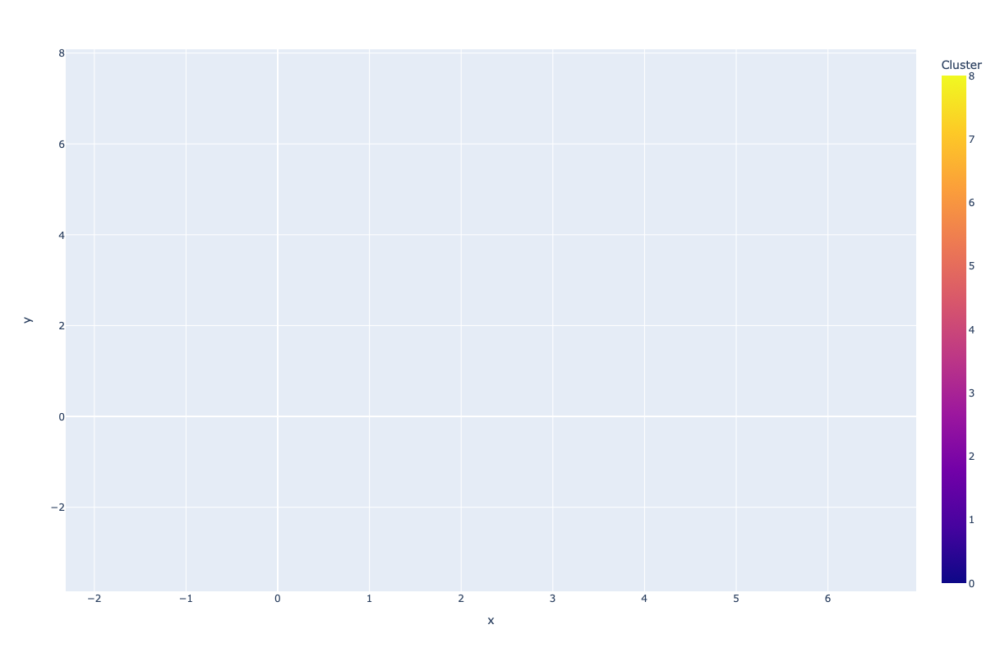

These two components explain 31.15% of the point variability.


<Figure size 1200x800 with 0 Axes>

In [24]:
plt.figure(figsize=(12, 8))

#Predict the cluster label for each point in the dataset
clusters = kmeans.fit_predict(z_score_df)

z_score_df['Cluster'] = clusters

#removes mean and scales
scaler = StandardScaler()

#Standardizes z_score_df 
stand_data_scaled = scaler.fit_transform(z_score_df)

# PCA analysis: Reduces dimentionallity to 2 principle components
pca = PCA(n_components=2).fit(stand_data_scaled)
pca_result = pca.transform(stand_data_scaled)

#Percentage of variance explained by each of the selected components.
variance_ratio = pca.explained_variance_ratio_

# Create a scatter plot
fig = px.scatter(x=pca_result[:, 0], y=pca_result[:, 1], color=clusters,
                 labels={'color': 'Cluster'},
                 #title='Cluster Plot against 1st 2 Principal Components',
                 opacity=0.7,
                 width=800, 
                 height=800)

plt.tight_layout()
fig.show()

print(f"These two components explain {(variance_ratio.sum()*100):.2f}% of the point variability.")

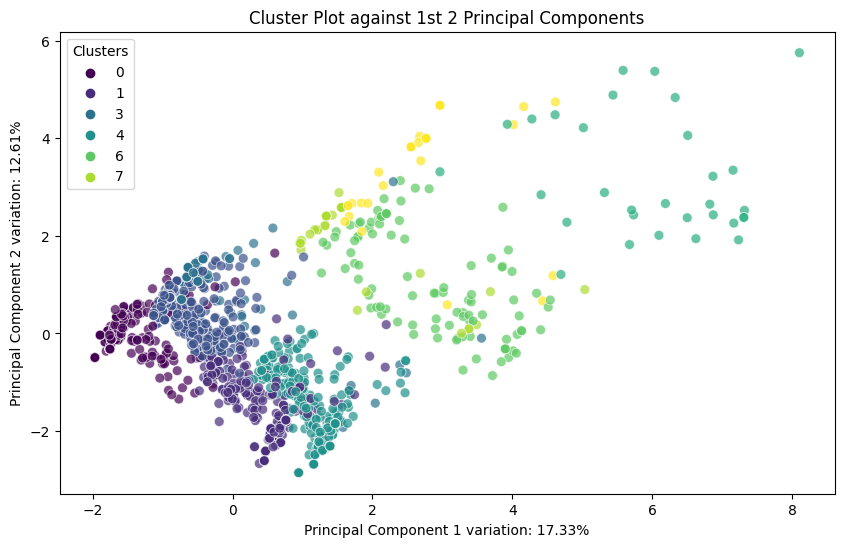

In [25]:
#applies PCA to reduce the dimensionality to 2 dimensions, and visualizes the clusters relationship to the 2 principle components.
clusters = kmeans.fit_predict(z_score_df)
z_score_df['Cluster'] = clusters

#Standardizes z_score_df 
scaler = StandardScaler()
stand_data_scaled = scaler.fit_transform(z_score_df)

# PCA analysis: Reduces dimentionallity to 2 principle components
pca = PCA(n_components=2).fit(stand_data_scaled)
pca_result = pca.transform(stand_data_scaled)

#Percentage of variance explained by each of the selected components.
variance_ratio = pca.explained_variance_ratio_

plt.figure(figsize=(10, 6))
sns.scatterplot(x=pca_result[:, 0], y=pca_result[:, 1], hue=clusters, palette='viridis', s=50, alpha=0.7)
plt.title('Cluster Plot against 1st 2 Principal Components')
plt.xlabel(f'Principal Component 1 variation: {variance_ratio[0]*100:.2f}%')
plt.ylabel(f'Principal Component 2 variation: {variance_ratio[1]*100:.2f}%')
plt.legend(title='Clusters')
plt.show()

The PCA plot shows distinct clusters amoungst the data. This suggests that the k-means algorithm was sucessful in finding distinct groups in the data. There is some overlap between the clusters indicating that some datapoints share similarities across clusters.

The plot shows that the 2 principle components describe 32.16% of the variance in the dataset, describing 13.48% and 18.67% respectively.

This indicates that there are more dimensions within the dataset which might be significant in descibing the variance.

The partial overlap in the clusters and relatively low variance desription, is due to the complex nature of car accidents. As discussed they are difficult to categorise as each crash is cause by a multitude of environmental, infrastructural and driver error variables.

#### Interpretation of cluster centers

Now what the clusters have been sucessfuly defined. It is important that we understand the variables that make up each cluster. 

The easiest way of interpreting the cluster centers is to visualise the Z-score distribution of each cluster.

By plotting these radialy, we can understand how each group varies relative to the whole sample.

In [26]:
# KMeans clustering
clusters = kmeans.fit_predict(z_score_df)

# Get the cluster centers
cluster_centers = kmeans.cluster_centers_


# Get the cluster centers
cluster_centers = pd.DataFrame(kmeans.cluster_centers_, columns=z_score_df.columns)


In [27]:
# KMeans clustering
clusters = kmeans.fit_predict(z_score_df)

# Retreive the cluster centers from the kmeans
cluster_centers = kmeans.cluster_centers_

#Convert the cluster centers to dataframe that shares names of z-score dataframe
cluster_centers = pd.DataFrame(kmeans.cluster_centers_, columns=z_score_df.columns)

We can now visualise each clusters z-score distribution using a radial plot. This will be shown for 1 cluster. The rest can be found in Apendix B.

The red line indicates the mean of each variable. The distance below and above the line indicate the number of standard deviations away from the mean each variable is.

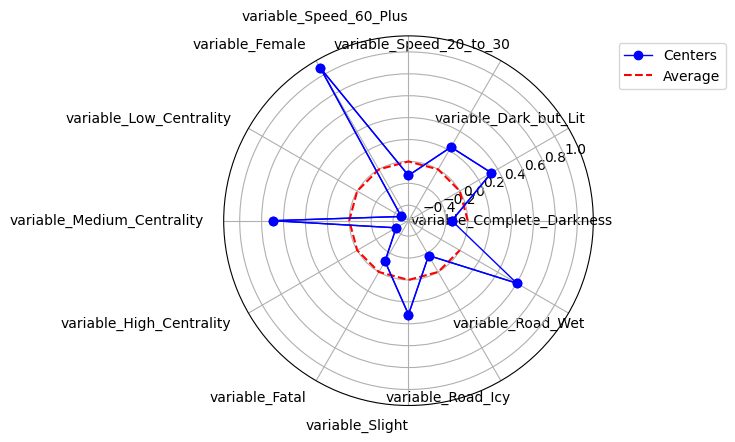

In [28]:
#Select the first cluster
first_row_centers = cluster_centers.iloc[0, :-1]

# len of features
num_features = len(first_row_centers)

# polar coordinates, Use endpoint = False to seperate the two last variables
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=False)

fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta, first_row_centers, linewidth=1, color='blue', marker='o', label='Centers')

# Add an extra red line at the 0.0.
ax.plot(theta, np.zeros_like(first_row_centers), color='red', linestyle='--', label='Average')

# Closing the plot to ensure the first and last points are connected
ax.plot(np.append(theta, theta[0]), np.append(first_row_centers, first_row_centers[0]), linewidth=1, color='blue', marker='o')

ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers.columns[:-1], rotation=45, ha='right')

#Plot the plot and legend
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1))
plt.show()

**Observations from Cluster 0**

The radial plot shows that cluster 0 is defined by the following variables:

* Female
* Medium Centrality
* Dark but lit
* Wet Roads
* Slight Severity
* 20-30 speed limit

This is repeated for each of the cluster centers. The custers are then renamed by their key variables for ease of visualisation in the final cluster map.

#### Consolidation

The clusters have now been createed and defined. The cluster data and output area shapefiles can be cleaned and consolidated.

In [29]:
#Retain only cluster and oa codes
z_score_df.drop([
'variable_Complete_Darkness', 'variable_Dark_but_Lit',
       'variable_Speed_20_to_30', 'variable_Speed_60_Plus', 'variable_Female',
       'variable_Low_Centrality', 'variable_Medium_Centrality',
       'variable_High_Centrality', 'variable_Fatal', 'variable_Slight',
       'variable_Road_Icy', 'variable_Road_Wet',], axis=1, inplace=True)


In [30]:

#Merge cluster data and edinbug ouput areas
results = z_score_df.merge(edinburgh_oa, on='code')

#Merge with standardised data so features of each OA are visible
results_2 = results.merge(df_percentages, on='code')

#Drop excess data.
results_2.drop(['objectid', 'hhcount', 'popcount', 'sqkm', 'hect', 'masterpc', 'easting', 'northing' 
                , 'council','shape_1_le','shape_1_ar', 'label', 'code', 
], axis=1, inplace=True)

In [31]:
#Rename clusters based on onservations
results_2['Cluster'] = results_2['Cluster'].astype('string')

#create funcion that renames the clusters
def rename_column(x): 
    x = x.replace('0', "0: Female, Medium Centrality, Wet roads, slow, severity slight")
    x = x.replace('1', "1: Medium Centrality, severity slight, slow speed")
    x = x.replace('2', "2: High centrality, slow speeds")
    x = x.replace('3', "3: Low centrality, slow speeds")
    x = x.replace('4', "4: Low centrality, high speeds")
    x = x.replace('5', "5: Fatal, medium centrality")
    x = x.replace('6', "6: Icy roads, dark but street lit")
    x = x.replace('7', "7: Complete darkness, medium centrality")
    x = x.replace('8', "8: High speeds, darkness, low centrality")
    return x

#Run function through the cluster column
results_2['Cluster'] = results_2['Cluster'].apply(rename_column)

In [32]:
#Convert to geodataframe
edin_map = gpd.GeoDataFrame(results_2, crs = 'EPSG:4326', geometry=results['geometry'])

## Results

Illustrate your findings organised, using clear and concise text, informative tables, and good visualizations. Explain the meaning and significance of your results, making connections to the research questions or any hypotheses outlined in the introduction.


#### Visualising edinburgh crashes and road network connectivity

In [59]:
#Folium heat map showing crashes across Edinburgh
map_center = [filter_data['Latitude'].median(), filter_data['Longitude'].median()]
crash_m = folium.Map(location=map_center, zoom_start=12, tiles='CartoDB positron')
location=filter_data[["Latitude","Longitude"]]
marker_cluster = plugins.MarkerCluster(location).add_to(crash_m)
heat_map = plugins.HeatMap(location,
                               radius=20,
                               blur=15,
                               ).add_to(crash_m)

folium.LayerControl().add_to(crash_m)
crash_m

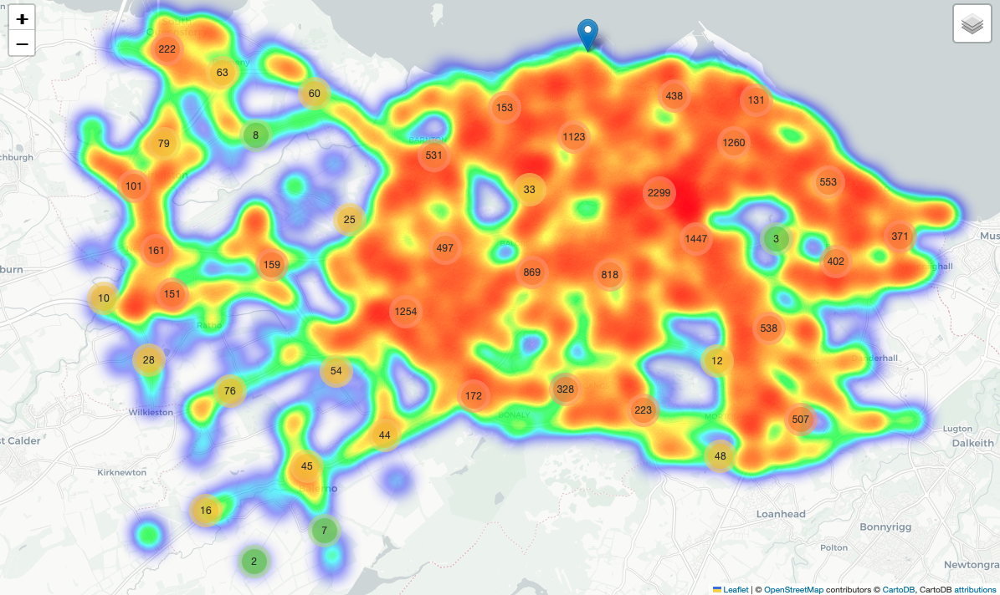
The heat map above shows the uneven distribution of car crashes across Edinburgh. It shows higher numbers of crashes along major roads and highways in and out of the city as well as the bypass South of the city. These higher rates of traffic and are therfore likely to experience higher crash rates.

The map also shows that most crashes in Edinburgh are recorded in the city center, with preipheral areas of the city exibiting significanly lower crash densities.

Closer inspection shows that across the city crash hotspots show a tendency to form at road junctions. This implies that degree centrality may be a significant factor influencing road accidents.

In [34]:
nodes.explore(tiles="cartodbdarkmatter", column="degree_centrality", marker_kwds={"radius": 3})

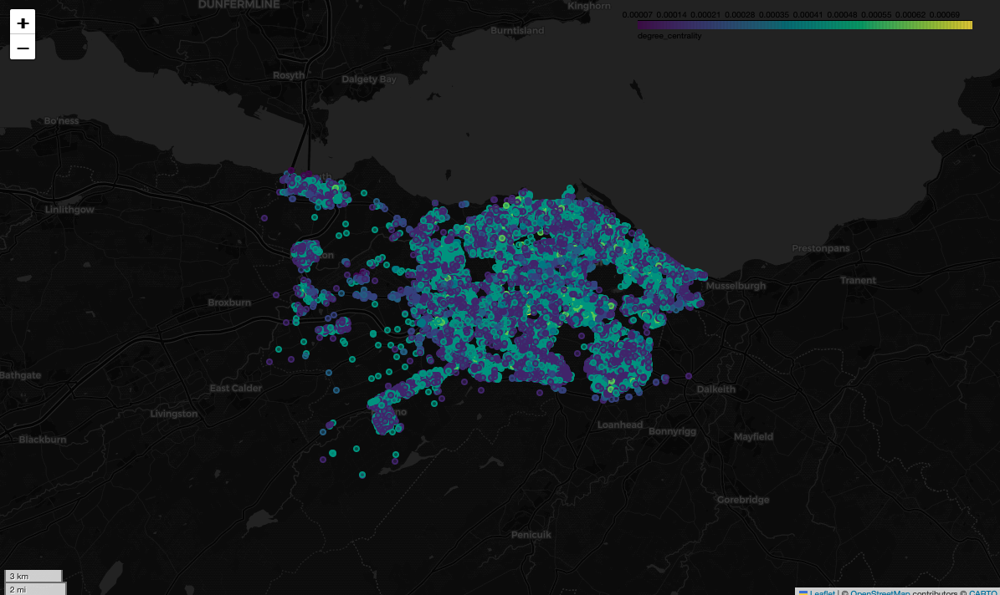
The plot above visualises the nodes in Edinburghs road network. The nodes are colored by their their degree of centrality. It shows a relatively even spread of node degree centralities across the city. Most nodes exhibit low to to medium centrality however there are some isolated instances of nodes of high centrality.

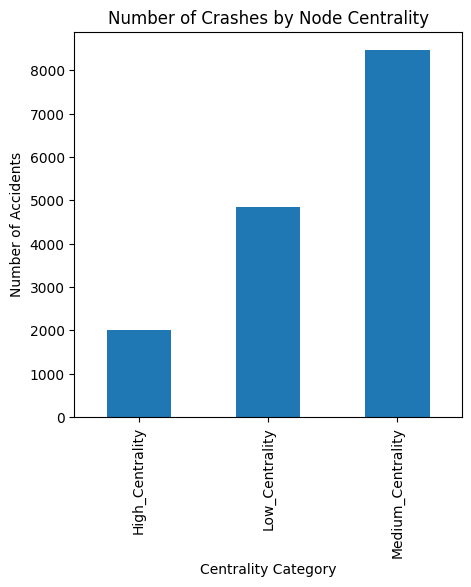

In [35]:
#Plot the distribution of node degree centrality
counts_per_node_degree = filter_data.groupby('centrality_category')['Accident_Index'].count()
counts_per_node_degree.plot(kind='bar', figsize=(5, 5))
plt.title('Number of Crashes by Node Centrality')
plt.xlabel('Centrality Category')
plt.ylabel('Number of Accidents')
plt.xticks(rotation=90)
plt.show()

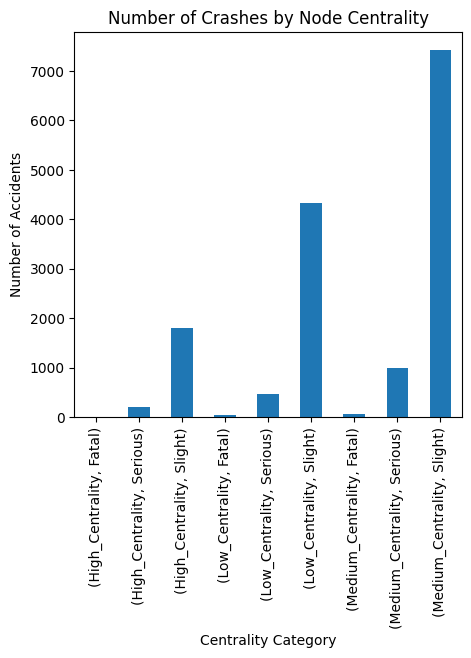

In [36]:
#Plot counts for number of crashes and severity per degree centrality category
counts_severity_node = filter_data.groupby(['centrality_category', 'Accident_Severity'])['Accident_Index'].count()
counts_severity_node.plot(kind='bar', stacked = True, figsize=(5, 5))
plt.title('Number of Crashes by Node Centrality')
plt.xlabel('Centrality Category')
plt.ylabel('Number of Accidents')
plt.xticks(rotation=90)
plt.show()

The bar chart above shows illustrates the distribution of accidents in relation to node centrality, classed by crash severity. It shows that most crashes happen closest to nodes of medium centrality and least next to a high centrality node. This is 

Aditionally, the data suggests that crashes near high centrality nodes are not necessarily more severe with most accidents across all centrality result in slight severity injuries. This indicates a lack of correlation between node centrality and crash severity.

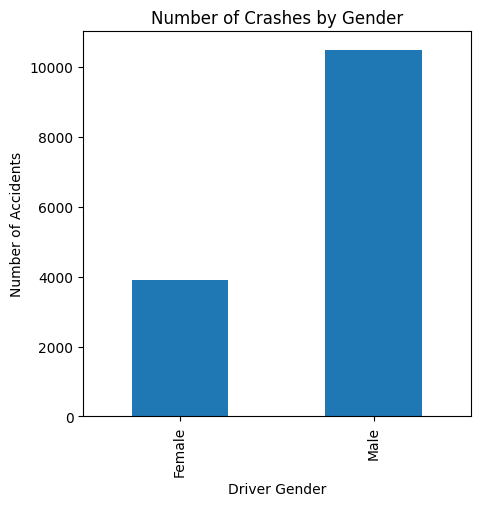

In [57]:
#Plot the distribution of gender
counts_per_node_degree = filter_data.groupby('Driver_Sex')['Accident_Index'].count()
counts_per_node_degree.plot(kind='bar', figsize=(5, 5))
plt.title('Number of Crashes by Gender')
plt.xlabel('Driver Gender')
plt.ylabel('Number of Accidents')
plt.xticks(rotation=90)
plt.show()

#### K-mean clusters for Edinburgh road accidents.

The process of k-means clustering data from 1500 road accidents in Edinbugh resulted in the creation of 9 distinct clusters.

The key variables of each of these clusters are listed below.

0.	Female, Medium Centrality, Wet roads, dark but lit, severity slight
1.	Medium Centrality, severity slight, slow speed
2.	High centrality, slow speeds
3.	Low centrality, slow speeds
4.	Low centrality, high speeds
5.	Fatal, medium centrality
6.	Icy roads
7.	Complete darkness, medium centrality
8.	High speeds, darkness, low centrality

Plotting these clusters across output areas in Edinbugh can reveal the spatial clustering of the crash types accross the city.trality

In [58]:
#Plot edinburgh output areas coloured by cluster
edin_map.explore(column='Cluster', cmap='Set3', tiles='CartoDB positron')

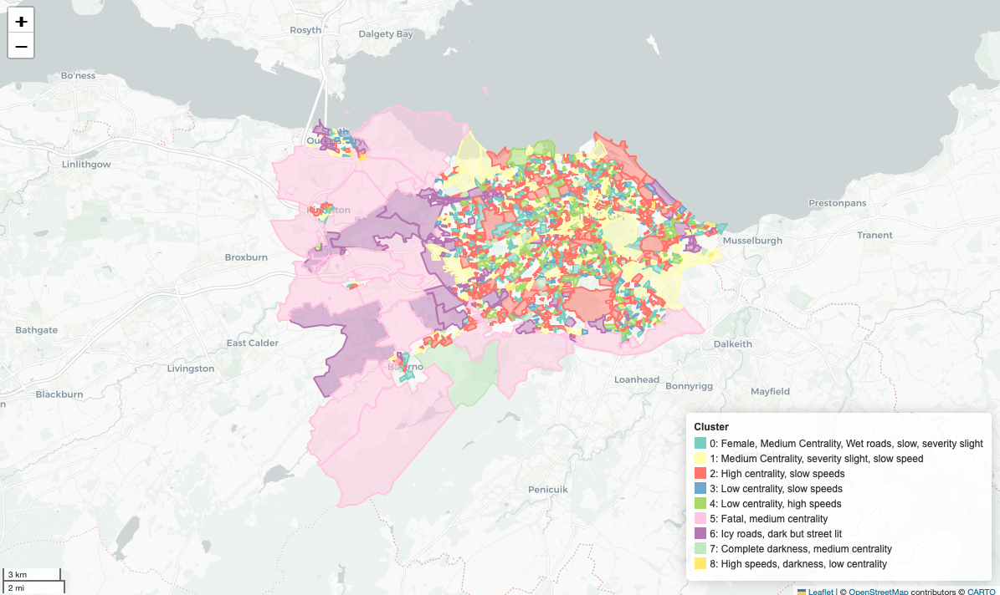
The map above shows a choropleth map of the Edinburgh output areas, with the colors indicating the 9  calculated k-means clusters derived from the crash data within them. It is notable that a few of the output areas have not been assigned a cluster. This is because these output areas lacked crash data and therefore could not be categorised. 

The k-means clustering model identified several distinct clusters across Edinburgh. There is a notable split in cluster patterns between inner city Edinburgh and the city fringe. The outer city is predominantly characterized by two extensive clusters that demarcate the city. One of these, cluster 6, extends into the city via the main roads from the West. It is also notable that built up areas in the outskirts of the city, such as towns, shows much more diverse clustering of output areas. These include Balerno, Ratho, Kirkliston and South Queensferry.

Conversely, central Edinburgh is made up of many smaller clusters. Some of the clusters appear to be scattered randomly. Often this is the case in output areas which reported only one or two crashes over the study period making them distinct. Some clusters, (e.g. custer 1), seem to run along 'veins', theses may be following particular roads or reflect different land uses. Clusters in the inner city appear to be disproportionatly highly influenced by the degree of centrality and speed limits. 

The more distinct clustering observed at the city limits might imply that accidents in these areas are more easily categorised than those in the center.

Examining the map in Appendix C shows that the split between inner and outer Edinburgh appears to align with the city bypass. This larger road type may explain the difference in crash categorisations as crashes on the bypass may be more uniform and predictable.

**City Outskirts**

Clusters 5 and 6 are notable as they make up the majority of the large output areas on the outskirts of Edinburgh. It is important to note that these clusters are made up of large ouput areas as this is a reason for them appearing so dominant.

Output areas in cluster 5 are categorised by greater than average fatality, and medium node centrality. Its distribution across Edinburgh shows that these output areas are generally the furthest from the city centre. A reason for this could potentially be that these output areas are on the outskirts and therefore positioned further from medical provision. As a result crashes in these areas might end in higher fatality levels.

Meanwhile, cluster 6 is dominated by icy road surfaces, as well as partially by dark, streetlamp lit roads. This could also be a result of these output areas being on the outskirts of the city and therefore not receiving the same provisions as more urban areas. An example of this could be that gritter routes might be focused on roads in the center of the city leading to greater icing at the city limits. Another potential cause could be the impact of the urban heat island effect. This is the phenomenon that more built up areas retain heat better than less built up areas and are therefore warmer (EPA, 2024). As a result, roads outside the city may be more succeptable to icing, leading to increased crashes. This cluster does also extend into the city via the main roads coming in from the East, and also in isolated output areas throughout the city.

**Inner City**

Output area clustering in the inner city appears to be more fragmented than at the city limits. However, there are a number of distinct clusters. Some  follow key infrastrucural and land use patterns. Cluster 1, for example is dominant in Edinburghs commercial and tourism center, making up all of Princess Street, extending down Leith Walk and also up to Aurthurs seat. These are areas with heavy foot traffic. This cluster is categorised by slow speeds, medium centrality and slight severity. It's distribution could indicative of areas with large amounts of infrastructural controls on vehicle movement such as speed lights, roundabouts and zebra crossings as a result of the high foot traffic.

Another example of this is cluster 4. This cluster shows some tendency to follow roads leading into the city. Crashes in in these output areas are categorised by low centrality and high speeds meaning that they are potentially roads with less highly connected junctions and higher speed limits.

The map also highlights much more isolated crash clusters, occuring in only 1 or two wards at a time. Cluster 0 is characterized by female drivers, medium centrality and wet roads. This cluster is spread across the city with no apparent clustering. There is also few isolated instances of cluster 8 (characterised by High speeds, darkness and low centrality) and cluster 7 (characterised by darkness and medium centrality) across Edinburgh. 

## Discussion

The k-means cluster model built in this analysis paints a picture of how a range of infrastructural, social and environmental elements converge inform a wide variety of different types of car accident. The granuality of the cluster analysis allows for the identification of localized problem areas.

The outputs of this analysis can help infom more specific road saftey decision making in Edinburgh. They combine some of the main factors contributing to road accidents across Edinburgh and highlights areas in need of either infrastuctural, social or service provision intervetion best reduce car accidents.

By heat mapping Edinburghs road accidents, we can see that the focus of policy makes should be in the center of Edinburgh as this is the area with the most accidents. Current efforts in Edinburgh have focused on the implimentation of 20mph speed limits across much of the capital. However, this analysis has shown that a one size fits all approach to managing road accidents at the scale of a city could be insufficient in managing the unique challenges faced by different areas of a netowrk. Instead, it has shown that interventions can be targeted to the specific characteristics influencing car accidents at a more granular scale.

Firstly, the model highlights potential lack of road saftey provision on the outskirts of the city, Here road accidents are categorized by higher fatalities and icier roads. In these areas, road saftey efforts should focus on impoving service provision in order to combat accidents and fatalities. For example, to combat the fatal accidents happening in areas within Cluster 5, the strategic stationing of more on call ambulances here could reduce accident response times, and in turn reduce fatalities. This intervention is supported by researc by the European Commission which found that the proportion of fatal crashes is lowest where ambulance availability is best and highest where ambulance availability is poor. (European Commission, nd). This could also help inform future hospital locations in the area.

Meanwhile, efforts in cluster 6 should focus on combatting icy road surfaces. The icing of road surfaces during colder months decreases vehicles grip on the road and can increase road accidents. This could be achieved by adjusting gritting routes, increasing the provision of grit bins or making drivers aware of the increased hazards in these areas. Further analysis of the gritting provisions in the city could help further infom this decision making.

The k-means cluster model, shows that the combating of road accidents in the city center requires much more  localised and specific intervention than in the outskirts. The crashes here are defined by more variables and in much smaller clusters.

Crashes in cluster 1 for example, are generaly less severe, slow and take place near moderatly connected nodes. Here the focus need not be on emergency service provision due to the less fatal nature of the crashes. Instead, interventions should target factors contributing to frequent but less severe crashes. This might include measure such as improving sinage, optimising junction control and traffic calming measures. Studies have found that traffic calming measures such as these sharpen drivers’ attention, and reduce junction conflict, resulting in fewer collisions (Ewing, nd)

In cluster 4, where high speed and low centrality are prevalent, the focus should be on reducing vehicle speed. This can be achieved by lowering the speed limits in these areas, installing speed cameras and increasing police presence in the area. These interventions may not be suitable in arterial roads due to the demand for fast flowing traffic. In these areas, traffic calming measures that keep drivers more alert may be more suitable.

Cluster 0 is noteable as it shows no apparent pattern and is the only cluster to include gender as a feature. The dataset shows that the vast majority of crashes in Edinburgh are caused by male drivers, yet the forming of cluster 0, characterized by higher proportion of accidents involving female drivers suggests the presence of unerlying factors that warrant investigation in these areas. From this, interventions can be shaped that tackle the higher proportion of female drivers.


## Conclusion

The global rise of traffic accidents is a critical problem, imposing economic costs and significanlty straining public health systems. The Scottish governement has been proactive in its efforts to combat road accidents, implementing agressive policy across Edinburgh. This has focused on the implimentation of strict and extensive 20mph sleed limits across the city which has proven successful in decreasing the frequency and severity of accidents in the capital.

However, the mulitfaceted nature of road accidents, driven by environmental, social and infarstuctural factors, necessitates a more nuances approach to takeling road saftey. Using machine learninin, this analysis  has sucessfully characterized a range of different crash types across Edinburgh, allowing us to understand better the localized and nuanced patterns of road accidents.

The findings show a harsh divide between patterns in the inner city and those occuring in the outskirts. Categorisations in the city outskirts, highlight potential service provision failures, leading to higher fatality crashes and icier roads. These areas call for enhanced emergency response provisions and improved road maintenence. On the other hand, Edinburghs inner city is characterised by smaller, more fragmented, and more local clusters each with their own unique characterisations. These areas require a range of targeted interventions such as improved traffic calming measures and in some cases street light provisions

The analysis has also highlighted the important role that node centrality in driving road accidents, with crashes in some areas being characterised by high levels of node centrality and others with very low. Identifying high risk junctions with high connectivity can help inform improved infrastructure decision making and reduce accidents.

In conclusion, the k-means clustering model has demonstrated its capability in providing some order and clarity in characterising the range of factors that contribute to road accidents. Destinct clusters demonstrate the presence of spatial patterns of road accidents. This analysis calls for a more granular data-driven apprach towards road saftey policy making. Interventions must be tailored to match the unique challenges faced by diffent communities. This approach could enhance the efficeiency of road saftey measures and reduce fatalities. Future policy must embrace the complex nature of road saftey challenges and can use a data-driven approach to form more creative, nuanced stratagies to tackle road accidents.


### Limitations

**Data set:** Although the dataset used in this analysis contained over 15000 accident reports, these were unevenly spread across Edinburgh. In instances where only 1 crash was reported in an output area, spatial clustering was distorted, contrbuting to a seeiming random clustering of some output areas.

Furthermore, this dataset is comprised of data up until 2016. This is somewhat outdated as the upscaling of Edinburghs 20mph limit zones occured in 2018. Therefore impact of this cannot be infered from this analysis.

**Compexity:** As highlighed by literature (Sinclair & Das, 2021), there is a huge range of variables that determine when, where and how car accidents occur globally. It has been highlighted that defining clear categorisations of car accidents is a difficult task beyond the scope of this analysis. Further research and data collection could be usefull in defining more explanatory crash clusters

**Node degree centrality:** This method of analysing node connectedness is limited in its explanatory power. It is limited to just measuring a nodes connectivity to the roads coming away and to it. Using degree betweenness would have been a much more suitable tool for analysing the role of node connectivity. This calculation considers the node in the context of the wider system, measuring its importance in conecting every other node in the system. This analysis was limited to degree centrality due to the computational power required to calculate node connectivity for the entire Edinburgh road network.

### Recomendations for further research

1. **Emergency response provision:** Investigate potential gaps in coverage in emergency services, particularly in the city limits


## Appendix

### Appendix A

Merging of two csv files.

The Accident_Information.csv and Vehicle_Information.csv can be found in the google drive. The paths of these datasets may require altering depending on how they have been saved.

In [ ]:
#Read in crash data csv
crashes = pd.read_csv("[YOUR PATH]/Data/Accident_Information.csv")

#Read in vehicle data
cars = pd.read_csv("[YOUR PATH]/Data/Vehicle_Information.csv", encoding='ISO-8859-1')

#Filter crash data to only include scottish data
scotland_crashes_df = crashes[crashes['InScotland'] == 'Yes']

#Merge crash and vehicle data on "Accident_Index"
crash_data = scotland_crashes_df.merge(cars, on = 'Accident_Index')

### Apendix B
Plotting of cluster centers

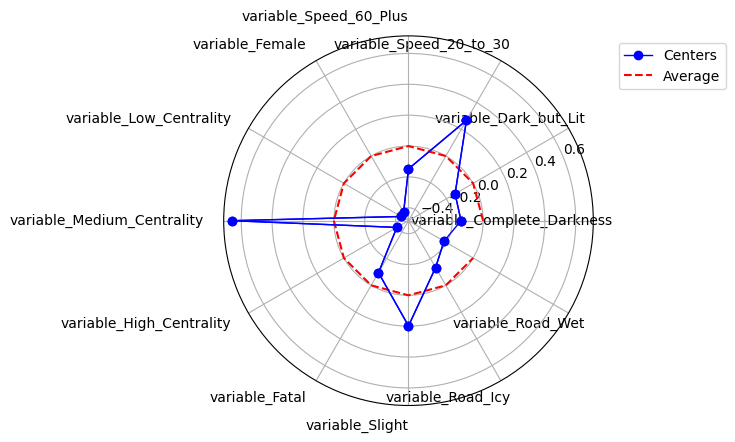

In [39]:
#Cluster 1 Plot
first_row_centers = cluster_centers.iloc[1, :-1]
# len of features
num_features = len(first_row_centers)
# polar coordinates, Use endpoint = False to seperate the two last variables
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=False)
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta, first_row_centers, linewidth=1, color='blue', marker='o', label='Centers')
# Add an extra red line at the 0.0.
ax.plot(theta, np.zeros_like(first_row_centers), color='red', linestyle='--', label='Average')
# Closing the plot to ensure the first and last points are connected
ax.plot(np.append(theta, theta[0]), np.append(first_row_centers, first_row_centers[0]), linewidth=1, color='blue', marker='o')
ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers.columns[:-1], rotation=45, ha='right')
#Plot the plot and legend
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1))
plt.show()

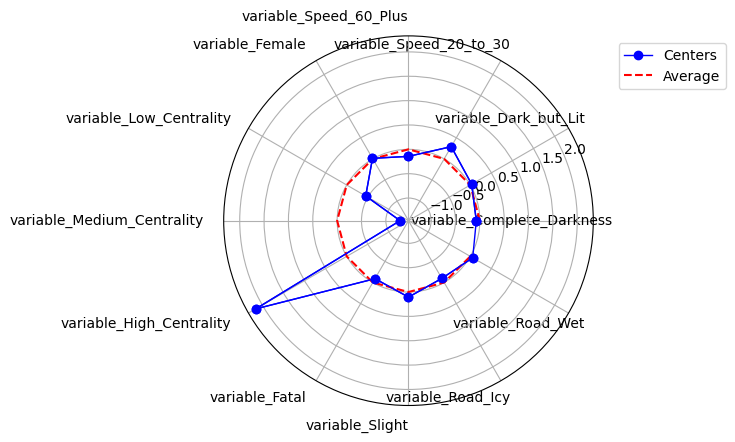

In [40]:
#Cluster 2 Plot
first_row_centers = cluster_centers.iloc[2, :-1]
# len of features
num_features = len(first_row_centers)
# polar coordinates, Use endpoint = False to seperate the two last variables
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=False)
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta, first_row_centers, linewidth=1, color='blue', marker='o', label='Centers')
# Add an extra red line at the 0.0.
ax.plot(theta, np.zeros_like(first_row_centers), color='red', linestyle='--', label='Average')
# Closing the plot to ensure the first and last points are connected
ax.plot(np.append(theta, theta[0]), np.append(first_row_centers, first_row_centers[0]), linewidth=1, color='blue', marker='o')
ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers.columns[:-1], rotation=45, ha='right')
#Plot the plot and legend
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1))
plt.show()

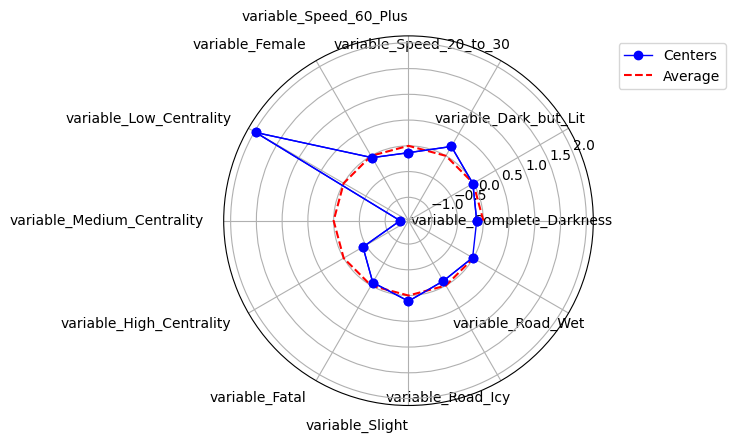

In [41]:
#Cluster 3 Plot
first_row_centers = cluster_centers.iloc[3, :-1]
# len of features
num_features = len(first_row_centers)
# polar coordinates, Use endpoint = False to seperate the two last variables
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=False)
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta, first_row_centers, linewidth=1, color='blue', marker='o', label='Centers')
# Add an extra red line at the 0.0.
ax.plot(theta, np.zeros_like(first_row_centers), color='red', linestyle='--', label='Average')
# Closing the plot to ensure the first and last points are connected
ax.plot(np.append(theta, theta[0]), np.append(first_row_centers, first_row_centers[0]), linewidth=1, color='blue', marker='o')
ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers.columns[:-1], rotation=45, ha='right')
#Plot the plot and legend
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1))
plt.show()

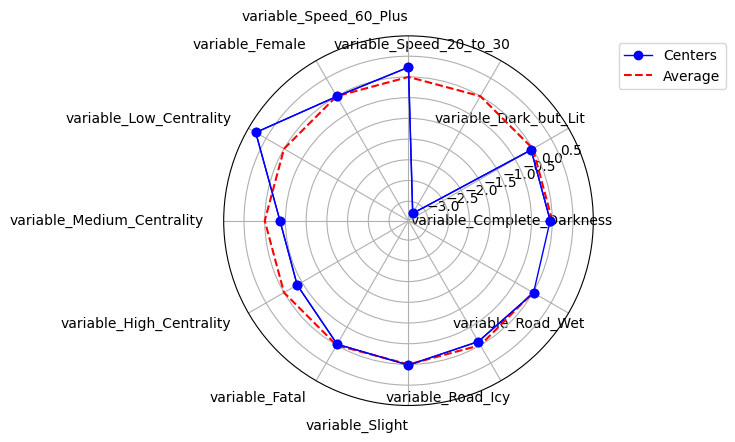

In [42]:
#Cluster 4 Plot
first_row_centers = cluster_centers.iloc[4, :-1]
# len of features
num_features = len(first_row_centers)
# polar coordinates, Use endpoint = False to seperate the two last variables
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=False)
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta, first_row_centers, linewidth=1, color='blue', marker='o', label='Centers')
# Add an extra red line at the 0.0.
ax.plot(theta, np.zeros_like(first_row_centers), color='red', linestyle='--', label='Average')
# Closing the plot to ensure the first and last points are connected
ax.plot(np.append(theta, theta[0]), np.append(first_row_centers, first_row_centers[0]), linewidth=1, color='blue', marker='o')
ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers.columns[:-1], rotation=45, ha='right')
#Plot the plot and legend
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1))
plt.show()

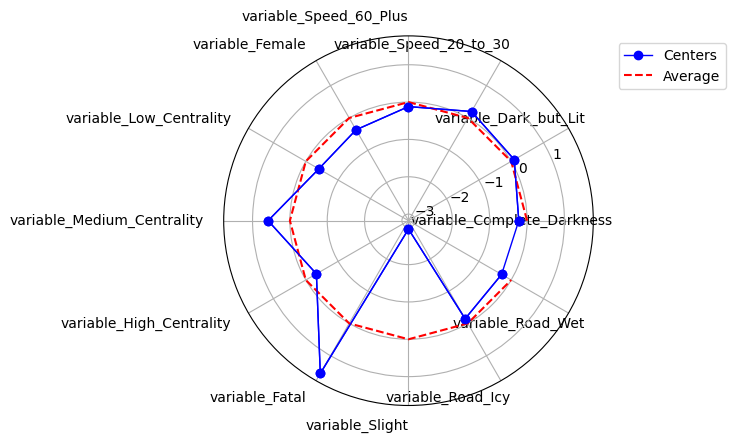

In [43]:
#Cluster 5 Plot
first_row_centers = cluster_centers.iloc[5, :-1]
# len of features
num_features = len(first_row_centers)
# polar coordinates, Use endpoint = False to seperate the two last variables
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=False)
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta, first_row_centers, linewidth=1, color='blue', marker='o', label='Centers')
# Add an extra red line at the 0.0.
ax.plot(theta, np.zeros_like(first_row_centers), color='red', linestyle='--', label='Average')
# Closing the plot to ensure the first and last points are connected
ax.plot(np.append(theta, theta[0]), np.append(first_row_centers, first_row_centers[0]), linewidth=1, color='blue', marker='o')
ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers.columns[:-1], rotation=45, ha='right')
#Plot the plot and legend
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1))
plt.show()

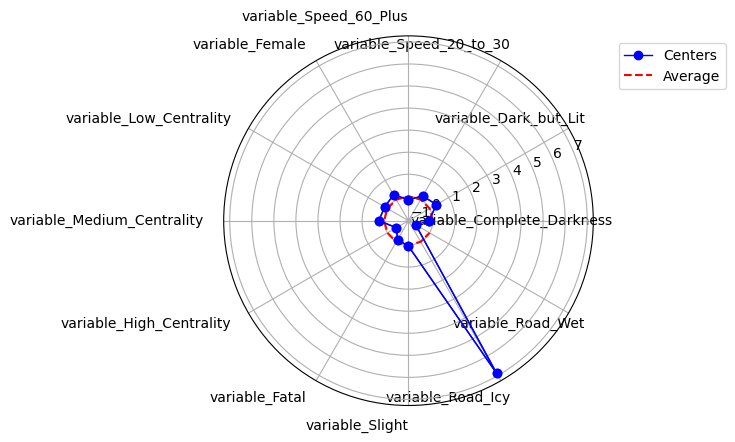

In [44]:
#Cluster 6 Plot
first_row_centers = cluster_centers.iloc[6, :-1]
# len of features
num_features = len(first_row_centers)
# polar coordinates, Use endpoint = False to seperate the two last variables
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=False)
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta, first_row_centers, linewidth=1, color='blue', marker='o', label='Centers')
# Add an extra red line at the 0.0.
ax.plot(theta, np.zeros_like(first_row_centers), color='red', linestyle='--', label='Average')
# Closing the plot to ensure the first and last points are connected
ax.plot(np.append(theta, theta[0]), np.append(first_row_centers, first_row_centers[0]), linewidth=1, color='blue', marker='o')
ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers.columns[:-1], rotation=45, ha='right')
#Plot the plot and legend
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1))
plt.show()

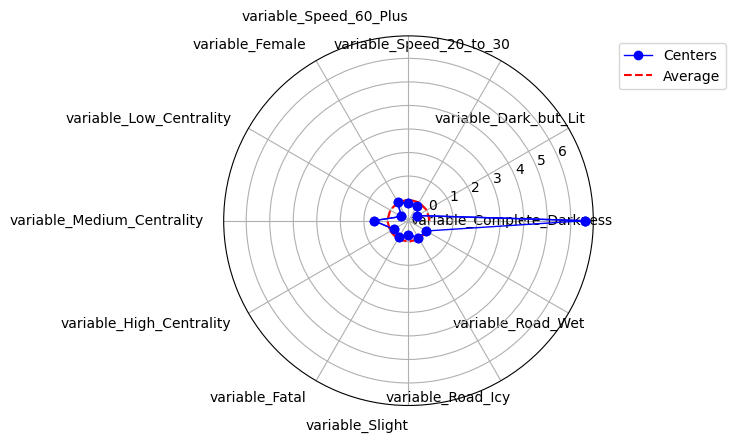

In [45]:
#Cluster 7 Plot
first_row_centers = cluster_centers.iloc[7, :-1]
# len of features
num_features = len(first_row_centers)
# polar coordinates, Use endpoint = False to seperate the two last variables
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=False)
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta, first_row_centers, linewidth=1, color='blue', marker='o', label='Centers')
# Add an extra red line at the 0.0.
ax.plot(theta, np.zeros_like(first_row_centers), color='red', linestyle='--', label='Average')
# Closing the plot to ensure the first and last points are connected
ax.plot(np.append(theta, theta[0]), np.append(first_row_centers, first_row_centers[0]), linewidth=1, color='blue', marker='o')
ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers.columns[:-1], rotation=45, ha='right')
#Plot the plot and legend
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1))
plt.show()

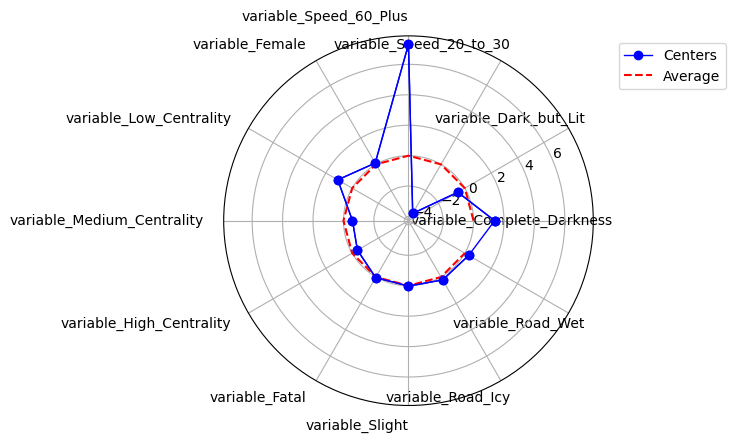

In [46]:
#Cluster 8 Plot
first_row_centers = cluster_centers.iloc[8, :-1]
# len of features
num_features = len(first_row_centers)
# polar coordinates, Use endpoint = False to seperate the two last variables
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=False)
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta, first_row_centers, linewidth=1, color='blue', marker='o', label='Centers')
# Add an extra red line at the 0.0.
ax.plot(theta, np.zeros_like(first_row_centers), color='red', linestyle='--', label='Average')
# Closing the plot to ensure the first and last points are connected
ax.plot(np.append(theta, theta[0]), np.append(first_row_centers, first_row_centers[0]), linewidth=1, color='blue', marker='o')
ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers.columns[:-1], rotation=45, ha='right')
#Plot the plot and legend
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1))
plt.show()

### Appendix C

K-means cluster map overlayed with speed limits.

In [47]:
keep_cols = ['Speed_limit', 'geometry', 'Accident_Index']

speedlimit = edinburgh_data[keep_cols]

speedlimit_gdf = gpd.GeoDataFrame(speedlimit, crs = 'EPSG:4326', geometry='geometry')

In [48]:
#create color pallete for speed limit
#Sort speed limits so they are not random
categories = sorted(speedlimit_gdf['Speed_limit'].unique())

colors = sns.color_palette("Reds", len(categories))

# Creating a dictionary to map categories to colours
color_dict = dict(zip(categories, colors))
color_dict

color_array1 = np.array([tuple(np.append(
    np.multiply(
        color_dict.get(x, (0, 0, 0)), 255).astype(int), 255)) 
                        for x in speedlimit_gdf['Speed_limit']],
                       dtype=np.uint8)

In [49]:
#create color pallete for speed limit
# Get unique categories
categories = sorted(edin_map['Cluster'].unique())

# colour seaborn's "tab10" color palette
colors = sns.color_palette("Set3", len(categories))

# We create a dictionary to map categories to colours
color_dict = dict(zip(categories, colors))
color_dict

import numpy as np
color_array2 = np.array([tuple(np.append(
    np.multiply(
        color_dict.get(x, (0, 0, 0)), 255).astype(int), 255)) 
                        for x in edin_map['Cluster']],
                       dtype=np.uint8)

In [50]:
#USe Lonboard to map the clusters and crash points 
#LOnboard is appropriate as there are many points to plot

warnings.filterwarnings('ignore')

# A GeoDataFrame with Point geometries
point_gdf = gpd.GeoDataFrame(speedlimit_gdf)
point_layer = ScatterplotLayer.from_geopandas(
    point_gdf,
    get_fill_color=color_array1,
    radius_scale = 50,

)

# A GeoDataFrame with Polygon geometries
polygon_gdf = gpd.GeoDataFrame(edin_map)
polygon_layer = SolidPolygonLayer.from_geopandas(
    polygon_gdf,
    get_fill_color=color_array2,
)
m = Map(
    layers=[polygon_layer, point_layer])

m

Map(layers=[SolidPolygonLayer(get_fill_color=<pyarrow.lib.FixedSizeListArray object at 0x19c759c00>
[
  [
    …

## References

* Dataset: https://www.kaggle.com/datasets/tsiaras/uk-road-safety-accidents-and-vehicles
* (No date a) EPA. Available at: https://www.epa.gov/green-infrastructure/reduce-urban-heat-island-effect#:~:text=%22Urban%20heat%20islands%22%20occur%20when,heat%2Drelated%20illness%20and%20mortality. (Accessed: 05 April 2024). 
* (No date) Scotland’s Road Safety Framework to 2030. Available at: https://framework.roadsafety.scot/wp-content/uploads/2021/05/Road-Safety-Framework-2030-May-2021.pdf (Accessed: 05 April 2024).
* The availability and response times ambulances (no date) European Commission. Available at: https://road-safety.transport.ec.europa.eu/european-road-safety-observatory/statistics-and-analysis-archive/post-impact-care/availability-and-response-times-ambulances_en# (Accessed: 05 April 2024).
* Ewing, R. (no date) Impacts of Traffic Calming. publication. Available at: https://nacto.org/docs/usdg/impacts_of_traffic_calming_ewing.pdf.
* Hunter, R.F. et al. (2022) ‘Investigating the impact of a 20 miles per hour speed limit intervention on road traffic collisions, casualties, speed and volume in Belfast, UK: 3 year follow-up outcomes of a natural experiment’, Journal of Epidemiology and Community Health, 77(1), pp. 17–25. doi:10.1136/jech-2022-219729.
* Nightingale, G.F. et al. (2021) ‘Evaluating the citywide Edinburgh 20mph speed limit intervention effects on traffic speed and volume: A pre-post observational evaluation’, PLOS ONE, 16(12). doi:10.1371/journal.pone.0261383.
* Pembuain, A., Priyanto, S. and Suparma, L. (2019) ‘The effect of road infrastructure on traffic accidents’, Proceedings of the 11th Asia Pacific Transportation and the Environment Conference (APTE 2018) [Preprint]. doi:10.2991/apte-18.2019.27.
* Sinclair, C. and Das, S. (2021) ‘Traffic accidents analytics in UK urban areas using K-means clustering for geospatial mapping’, 2021 International Conference on Sustainable Energy and Future Electric Transportation (SEFET) [Preprint]. doi:10.1109/sefet48154.2021.9375817. 